# Tag Segmentation with the iPython Notebook
The iPython Notebook consists of a series of cells you can run code in. The Notebook remembers what you wrote previously.  
Execute a cell by typing shift-enter

In [ ]:
year = 2015
print(year)

In [ ]:
print(year)

The notebook allows you to prototype code and plots quickly without having to reload data in each time. Can can be useful if you're experimenting with your data and it takes several minutes  to load into Python each time. However, you have to be careful when changing variables and the order you execute cells in, otherwise you may end up with different values than you expect.

In [1]:
year = 2016

## Handy Notebook Tips
* Tab completion: Press tab and variables will be completed or suggestions made.
* Multiple selections: Hold down command and click in multiple areas to make edits at the same time.
* Indendation: Notebook automaticlly indents Python code.
* Shift-tab-tab for docs: Press this when you're in the paratheses of a function from a module to get documentation.
* File Locations: Can be absolute or relative to the notebook.
* Cutting, pasting, inserting and moving cells: Can use buttons in the menu to modify cells.
* You can run notebook through another server/cluster

## Markdown
* A way to format text easily which is much **easier** to read and less hassle than HTML.
* You can also write HTML in the notebook if you prefer.
* Double-click cell to view the markdown.
* Lots of sites use it, GitHub, Stack Overflow. GitHub also supports the iPython notebook in the _browser_.
* Useful for documenting your code.
* You can select the option to create a Markdown cell from the top bar.
* You can create lists (like this).
* Link to other content (some of which are used for books and teaching):
    - [Extended Introduction to Computer Science Course](https://github.com/yoavram/CS1001.py)
    - [Introduction to Python](http://introtopython.org)
    - [Python for Developers](http://ricardoduarte.github.io/python-for-developers/)
    - [Probabilistic Programming & Bayesian Methods for Hackers](http://camdavidsonpilon.github.io/Probabilistic-Programming-and-Bayesian-Methods-for-Hackers/)
    - [Exploratory computing with Python](http://mbakker7.github.io/exploratory_computing_with_python/)
    - [Learn Data Science](http://learnds.com)
    - [Machine Learning](http://nbviewer.ipython.org/github/temporaer/tutorial_ml_gkbionics/tree/master/)
    - [More Machine Learning](http://nbviewer.ipython.org/github/masinoa/machine_learning/tree/master/)
    - [Pandas](https://bitbucket.org/hrojas/learn-pandas)
    - [List of Notebooks](https://github.com/ipython/ipython/wiki/A-gallery-of-interesting-IPython-Notebooks)
* [GitBook also uses markdown](https://www.gitbook.com/book/0xax/linux-insides/details)

### Different
#### Heading
##### Sizes
###### Too

You can even embed code in Markdown with syntax highlighting:

```python
sports = ["tennis", "cricket", "rugby", "football"]
for each_sport in sports:
    print(each_sport)
```

## Magic Functions
* Used to modify the iPython Notebook.
* We'll use one for displaying images soon.
* Now we'll use the reset command to wipe all variables.

In [ ]:
%reset

In [ ]:
print(year)

# How I've been using the notebook
Don't worry about specifics of the code, this is just a demo of how I've found the notebook useful, I'm not trying to teach you about image processing. I'll put this notebook online so you can go back to code if you're interested.

I've been trying to take video of tagged bees I've been filming and track the reflective tags. I've been using the notebook to rapidly test out my code and view the results.

## Import Modules

In [2]:
import cv2
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np

# another magic function, this allows you to view plots in the notebook
%matplotlib inline

## Read Images

In [10]:
first = ["tags/first0.png", "tags/first1.png", "tags/first2.png", "tags/first3.png", "tags/first4.png", "tags/first5.png"]
second = ["tags/second0.png", "tags/second1.png", "tags/second2.png", "tags/second3.png"]
queen = ["tags/queen0.png", "tags/queen1.png", "tags/queen2.png"]
mixed = []
for image_location in [first[0], second[0], queen[0]]:
    image = cv2.imread(image_location, 1)
    mixed.append(image)

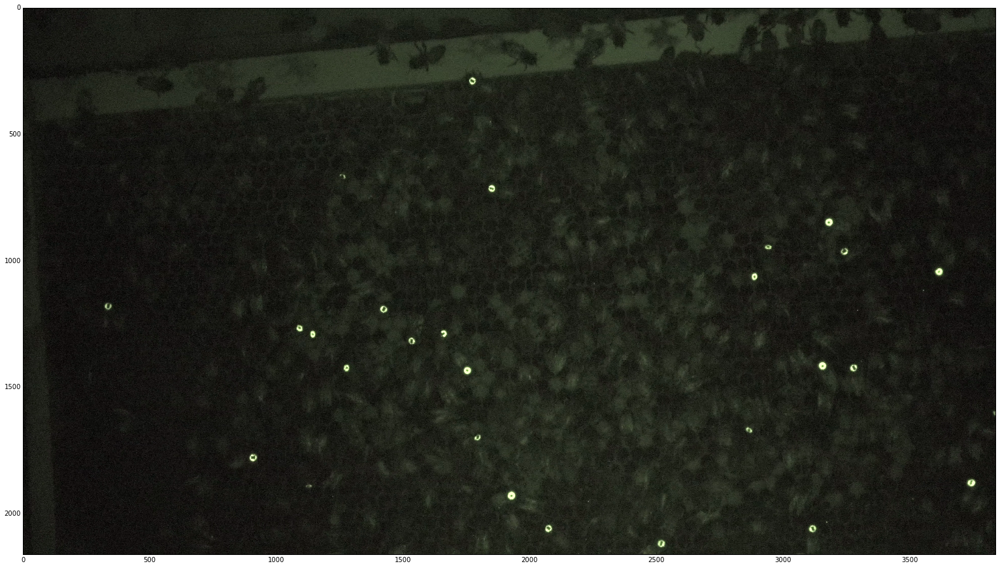

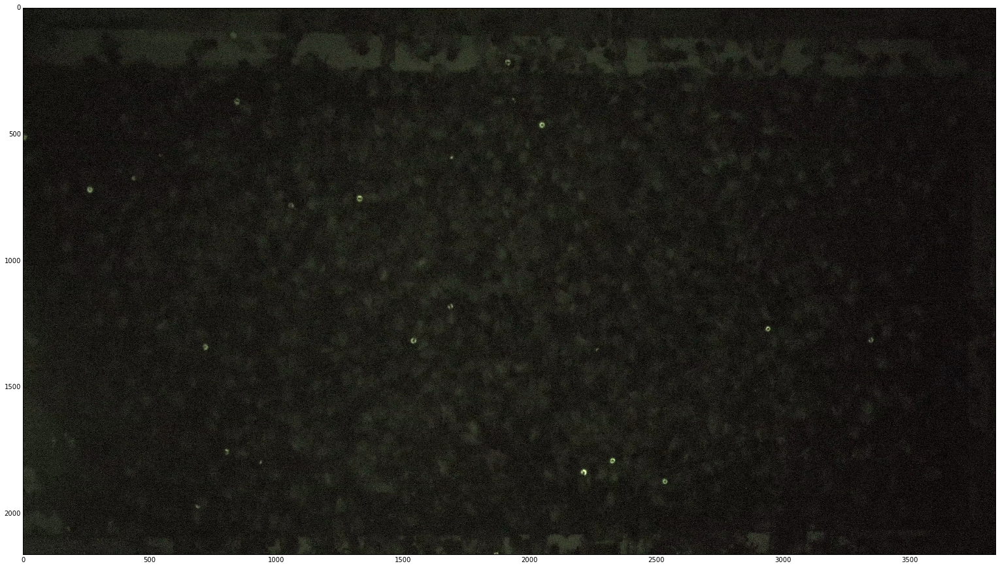

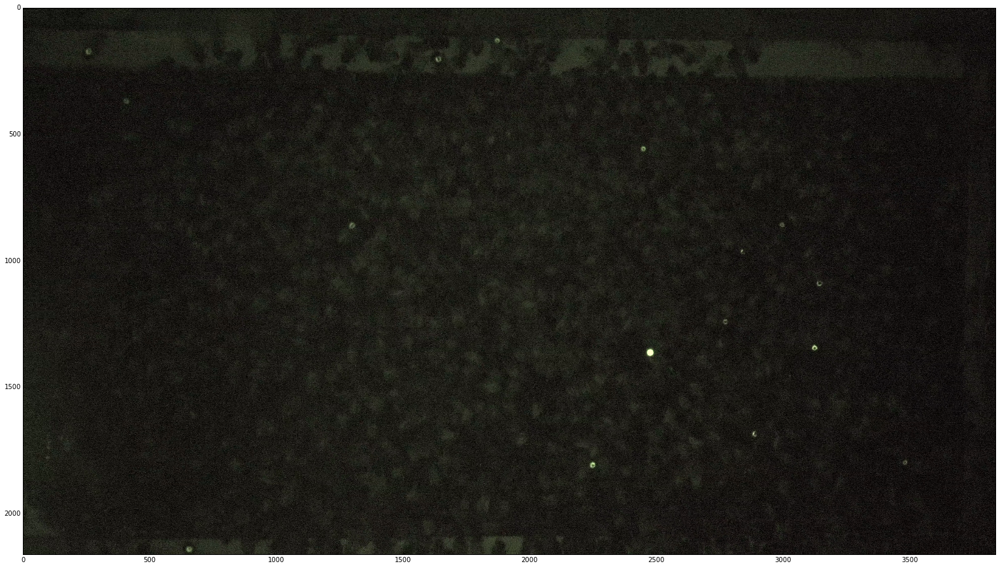

In [11]:
for image in mixed:
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    plt.figure(figsize = (27, 15))
    plt.imshow(image, cmap = cm.Greys_r)

I now have three 4K images loaded into the notebook. So long as I do not overwrite them, or change the original variables, I no longer have to repeatedly read these images in to memory when I run my program.

## Example with Blurring and Thresholding
Here I test out different parameters for the blurring and thresholding functions.

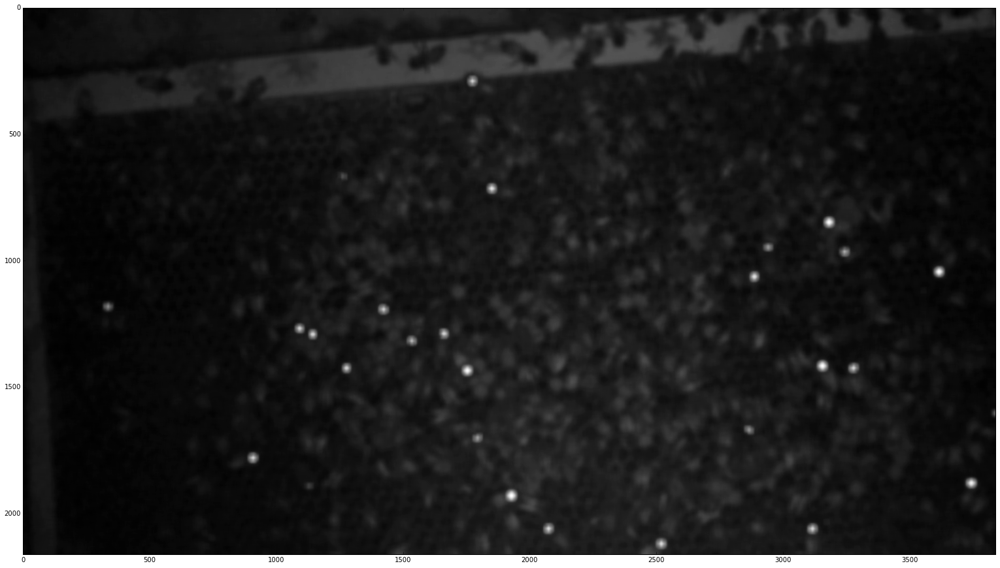

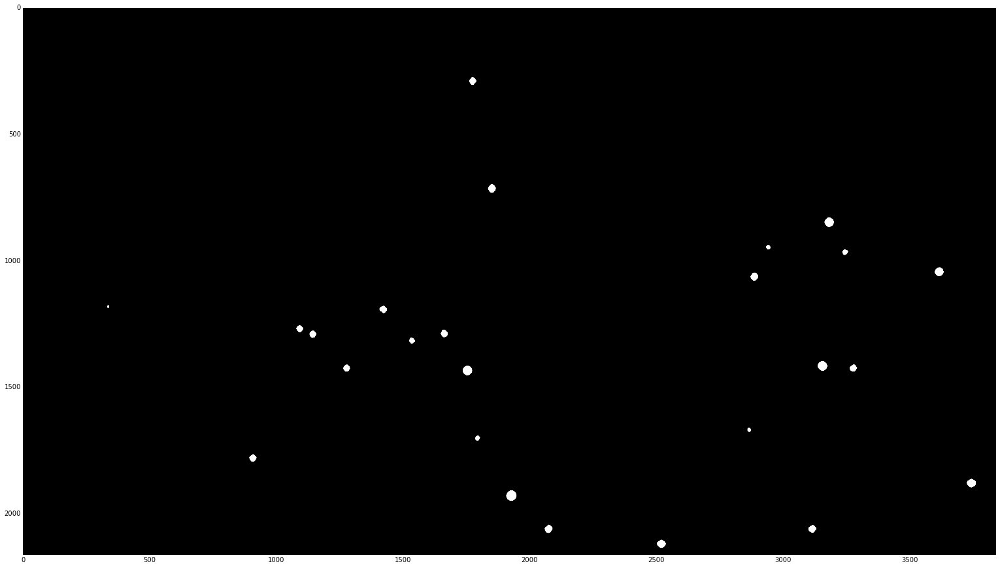

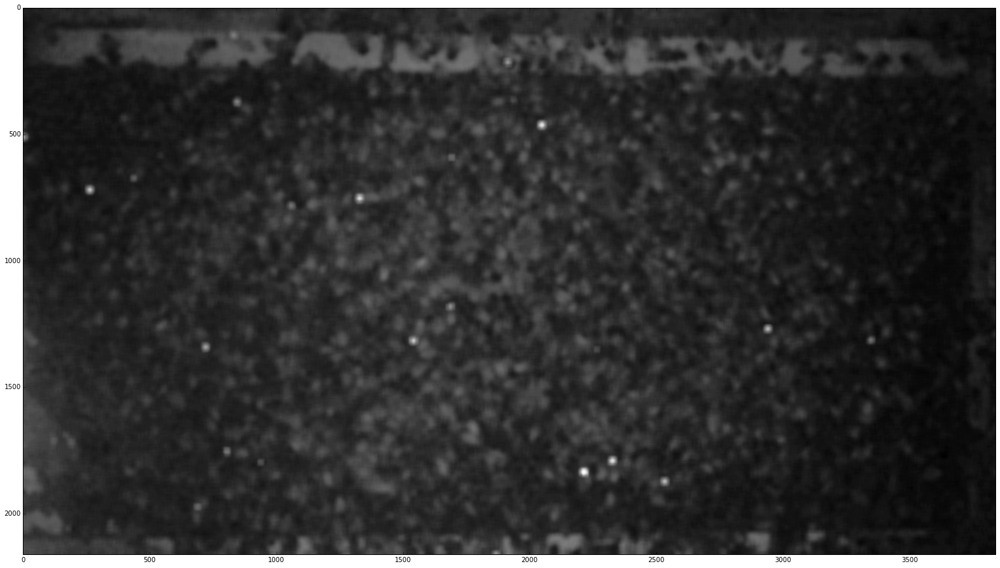

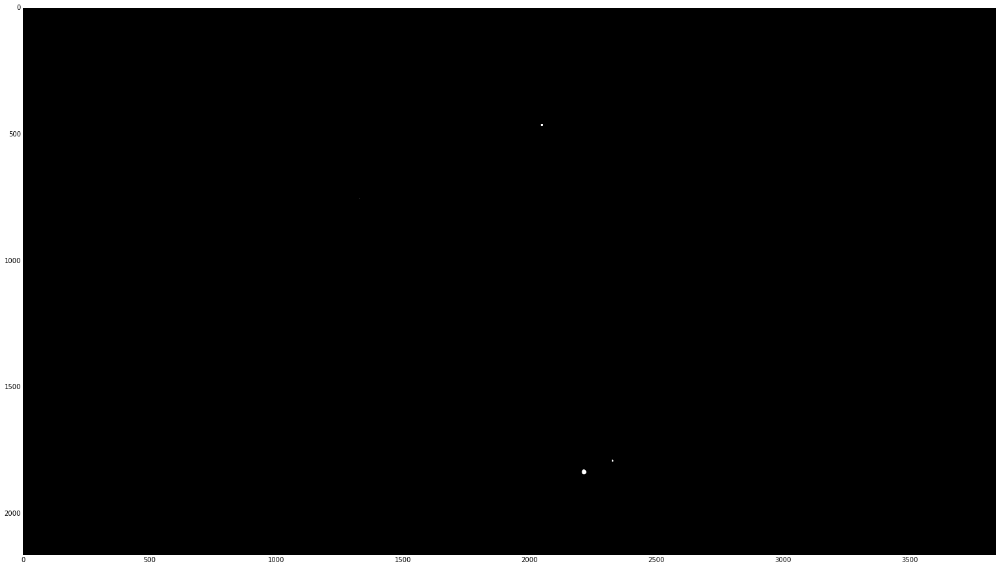

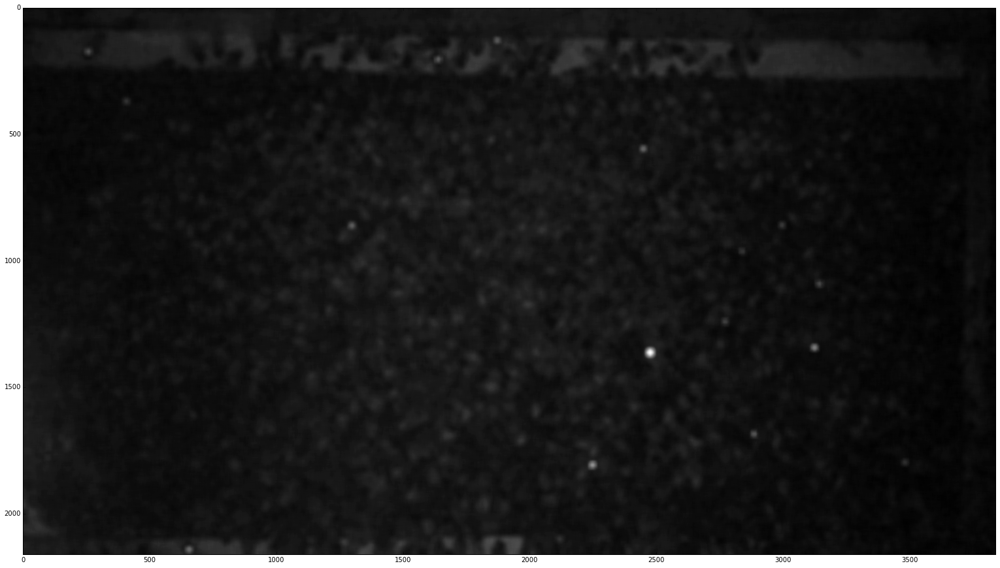

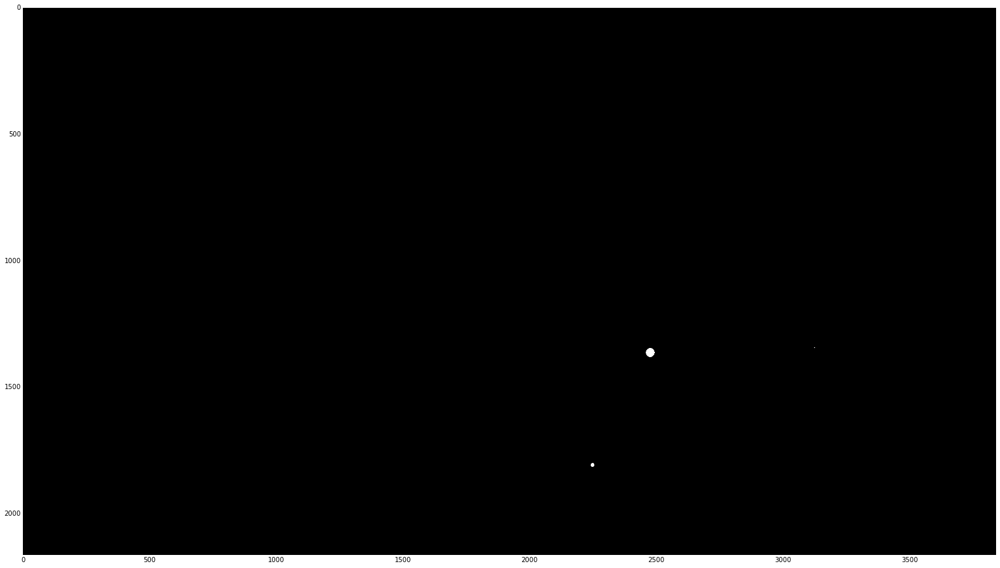

In [13]:
for image in mixed:
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    smoothed = cv2.blur(gray_image, (25, 25))
    ret, thresh = cv2.threshold(smoothed, 90, 255, cv2.THRESH_BINARY)
    
    plt.figure(figsize = (27, 15))
    plt.imshow(smoothed, cmap = cm.Greys_r)
    
    plt.figure(figsize = (27, 15))
    plt.imshow(thresh, cmap = cm.Greys_r)

## Canny

In [ ]:
lowThreshold = 50
ratio = 3

for image in mixed:
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    smoothed = cv2.GaussianBlur(gray_image, (9, 9), 0)
    edges = cv2.Canny(smoothed, lowThreshold, lowThreshold * ratio, apertureSize=3)
    ret, thresh = cv2.threshold(edges, 100, 255, cv2.THRESH_BINARY)
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
    drawn_image = image.copy()
    cv2.drawContours(drawn_image, contours, -1, (255,0,0), 3)
    plt.figure(figsize = (27, 15))
    plt.imshow(drawn_image)

## Laplacian

In [ ]:
for image in mixed:
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    #smoothed = cv2.GaussianBlur(gray_image, (7, 7), 0)
    #smoothed = cv2.GaussianBlur(gray_image, (9, 9), 0)
    smoothed = cv2.medianBlur(gray_image, 5)
    #smoothed = cv2.blur(gray_image, (5,5))
    edges = cv2.Laplacian(smoothed, cv2.CV_16S, ksize=3, scale=1, delta=0)
    edges = cv2.convertScaleAbs(edges)
    plt.figure(figsize = (27, 15))
    plt.imshow(edges, cmap = cm.Greys_r)
    
    #ret, thresh = cv2.threshold(edges, 10, 255, cv2.THRESH_BINARY)
    
    #plt.figure(figsize = (27, 15))
    #plt.imshow(thresh, cmap = cm.Greys_r)
    #opening = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, cv2.getStructuringElement(cv2.MORPH_RECT,(5, 5)))
    #opening = cv2.dilate(opening,cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(17, 17)), 1)
    
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
    #kernel = np.ones((13,13),np.uint8)
    #opening = cv2.dilate(opening,cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(11, 11)), 1)
    drawn_image = image.copy()
    for i, cnt in enumerate(contours):
        area = cv2.contourArea(contours[i])
        if area > 200:
            cv2.drawContours(drawn_image, contours, i, (255,0,0), 5)
    
    #plt.figure(figsize = (27, 15))
    #plt.imshow(image)
    plt.figure(figsize = (27, 15))
    plt.imshow(drawn_image)
    print("\n")

## Sobel

In [ ]:
for image in mixed:
    grad_x = cv2.Sobel(image, cv2.CV_16S, 1, 0, ksize=3, scale=3, delta=20, borderType=cv2.BORDER_DEFAULT)
    grad_y = cv2.Sobel(image, cv2.CV_16S, 0, 1, ksize=3, scale=3, delta=20, borderType=cv2.BORDER_DEFAULT)
    abs_grad_x = cv2.convertScaleAbs(grad_x)
    abs_grad_y = cv2.convertScaleAbs(grad_y)
    edges = cv2.addWeighted(abs_grad_x, 0.5, abs_grad_y, 0.5, 0)
    
    plt.figure(figsize = (27, 15))
    plt.imshow(image, cmap = cm.Greys_r)
    plt.figure(figsize = (27, 15))
    plt.imshow(edges, cmap = cm.Greys_r)

## Scharr

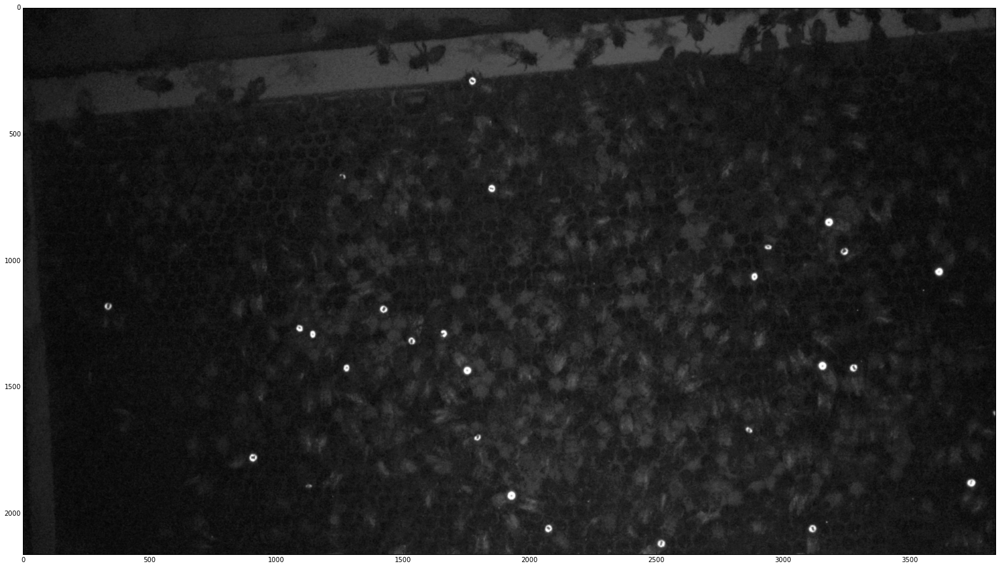

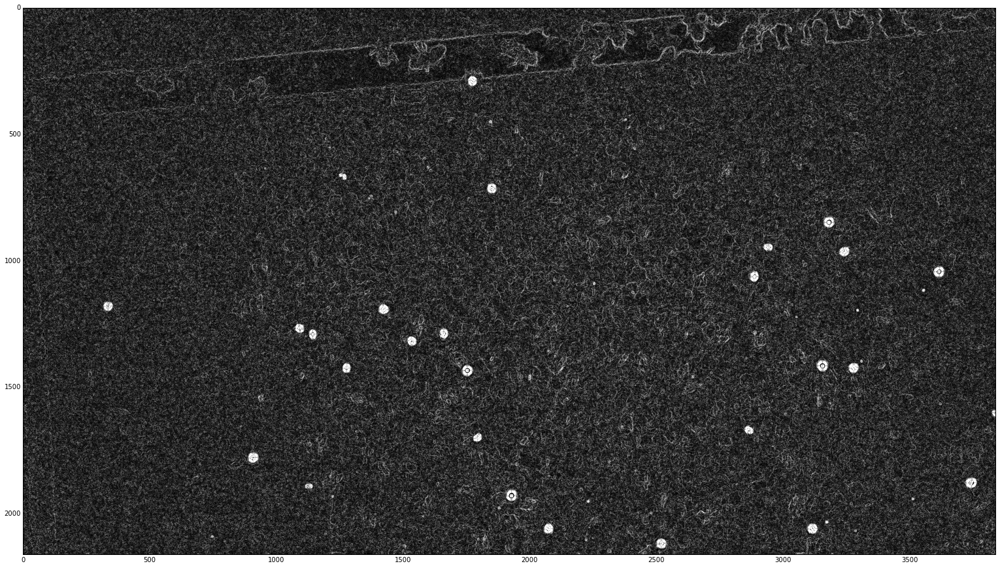

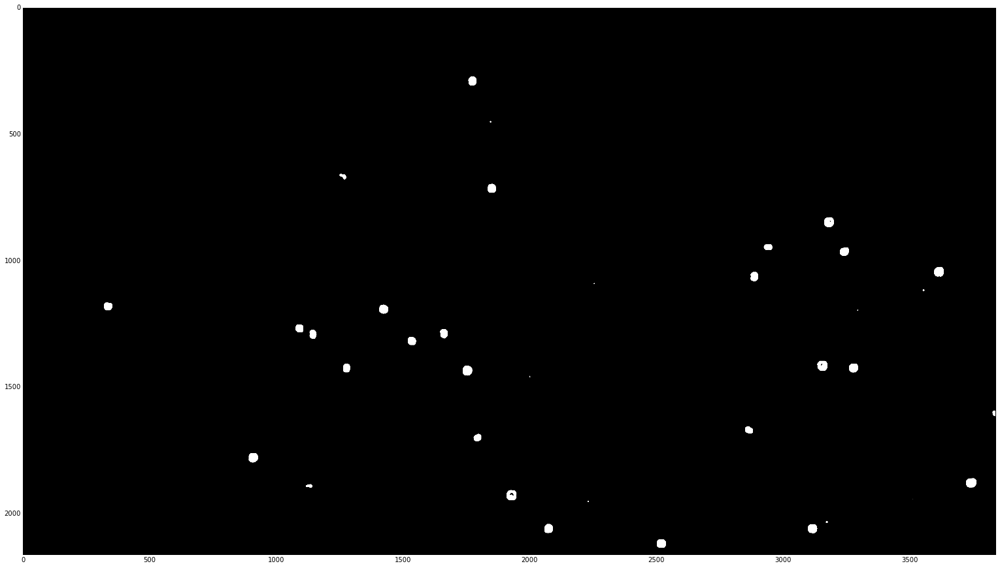

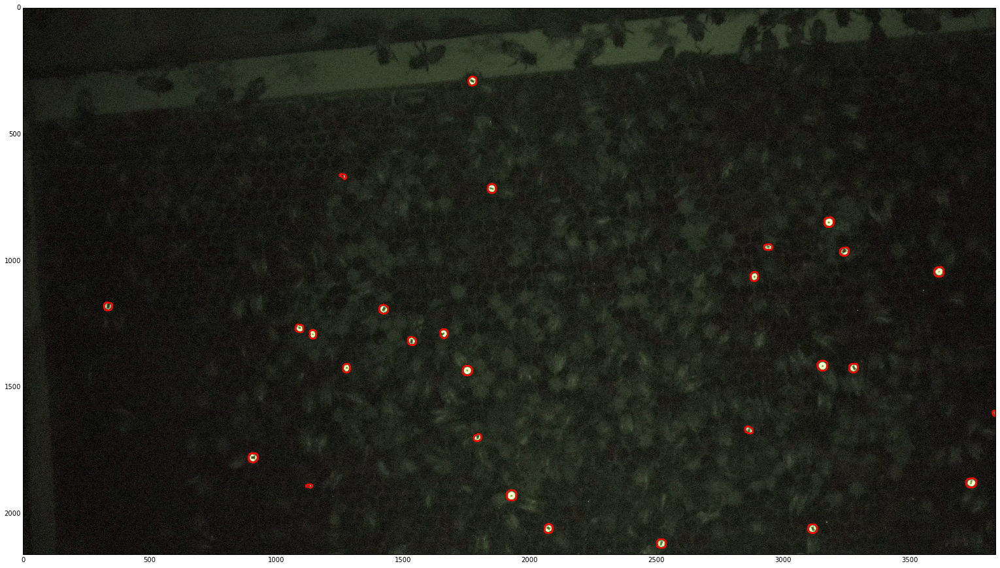

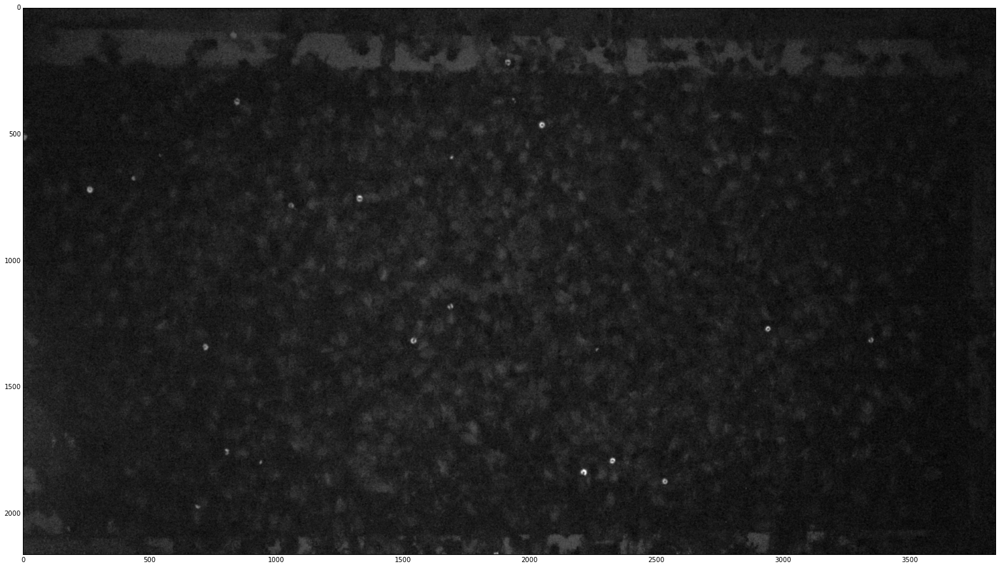

...

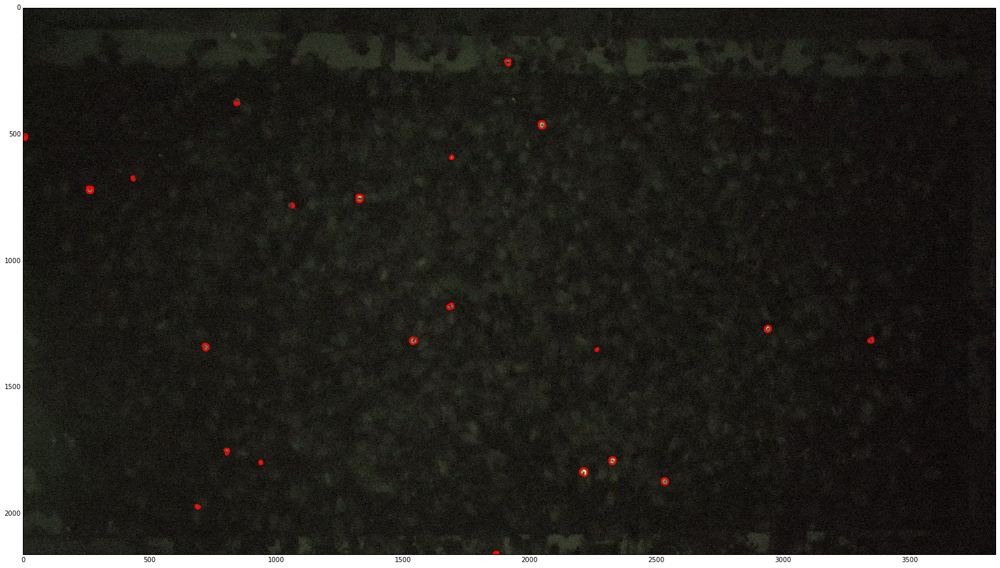

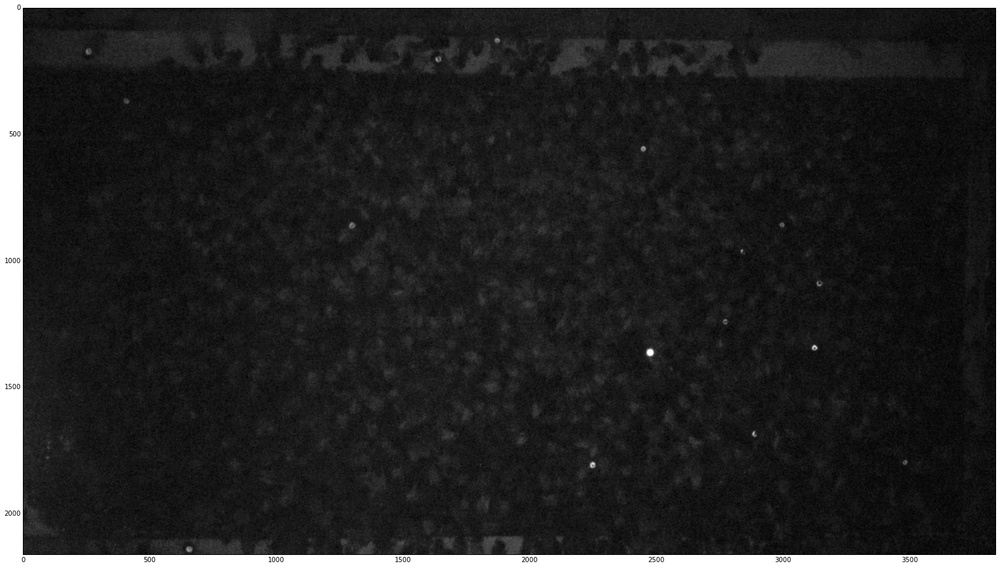

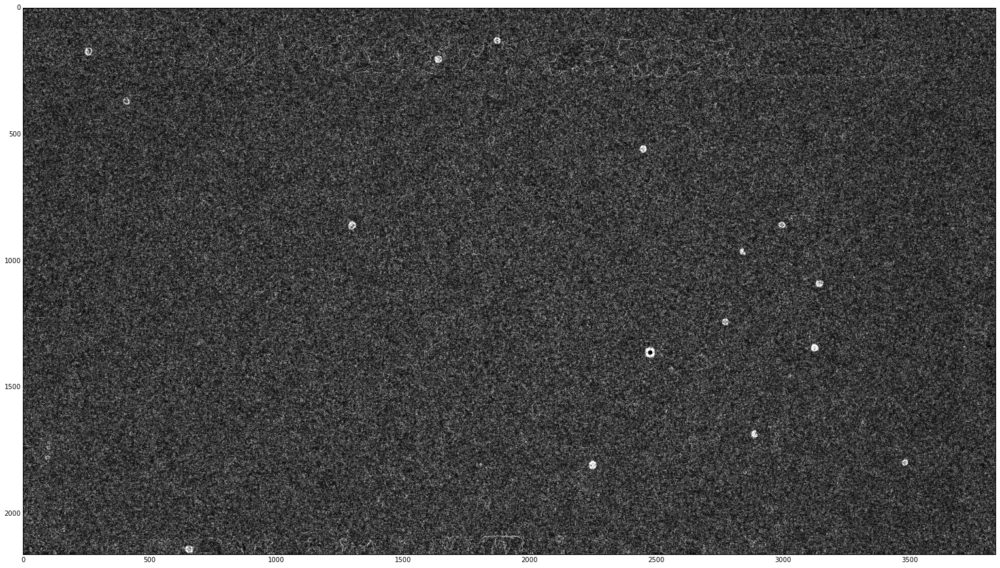

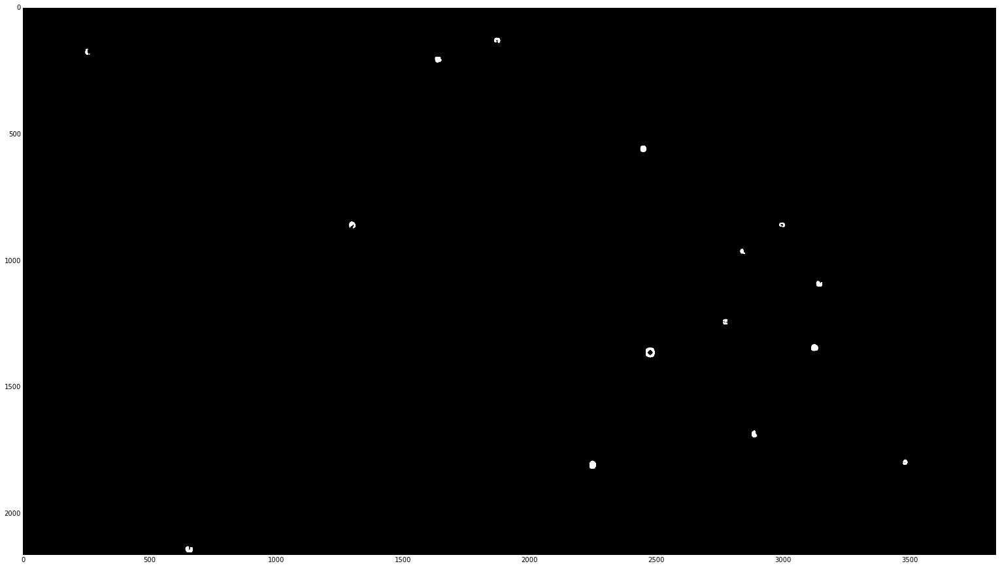

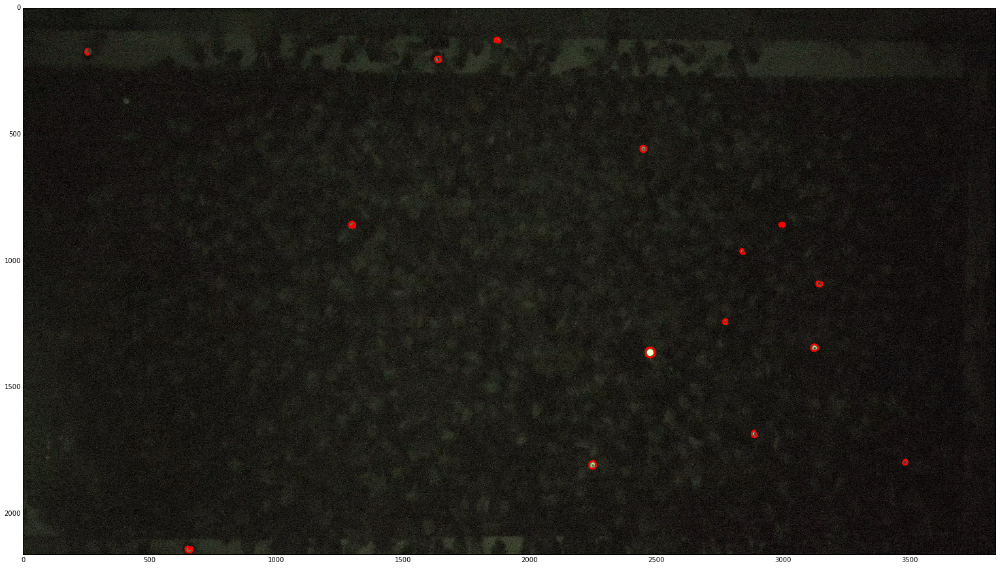

In [14]:
for image in mixed:
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    smoothed = cv2.GaussianBlur(gray_image, (9, 9), 0)
    #smoothed = cv2.medianBlur(gray_image, 3)
    #smoothed = cv2.blur(gray_image, (5,5))
    
    plt.figure(figsize = (27, 15))
    plt.imshow(smoothed, cmap = cm.Greys_r)
    
    grad_x = cv2.Scharr(smoothed, cv2.CV_16S, 1, 0, scale=1.5, delta=1, borderType=cv2.BORDER_DEFAULT)
    grad_y = cv2.Scharr(smoothed, cv2.CV_16S, 0, 1, scale=1.5, delta=1, borderType=cv2.BORDER_DEFAULT)
    abs_grad_x = cv2.convertScaleAbs(grad_x)
    abs_grad_y = cv2.convertScaleAbs(grad_y)
    edges = cv2.addWeighted(abs_grad_x, 0.5, abs_grad_y, 0.5, 0)
    
    plt.figure(figsize = (27, 15))
    plt.imshow(edges, cmap = cm.Greys_r)
    
    edges = cv2.blur(edges, (11,11))
    ret, thresh = cv2.threshold(edges, 140, 255, cv2.THRESH_BINARY)
    
    plt.figure(figsize = (27, 15))
    plt.imshow(thresh, cmap = cm.Greys_r)
    
    opening = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(5, 5)))
    

    contours, hierarchy = cv2.findContours(opening, cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
    drawn_image = image.copy()
    for i, cnt in enumerate(contours):
        area = cv2.contourArea(contours[i])
        if area > 100:
            cv2.drawContours(drawn_image, contours, i, (255,0,0), 5)

    plt.figure(figsize = (27, 15))
    plt.imshow(drawn_image)

    print("\n")

## Advantages
* Does it take several minutes to load data you're exploring into Python?
* Are you tweaking different plots and want to rapidly see and compare the different graphics?
* Great way to keep the code and the plots generated together and for viewing later.
* Exporting options: Download as HTML, PDF, etc or host on github.